In [25]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import statsmodels.api as sm 
sns.set()
%matplotlib inline


In [26]:
db = pd.read_csv('../10ac_week1/data.csv', na_values=['?', None])
pd.options.display.max_columns = None
pd.options.display.max_rows = None

In [27]:
db.head()

,Bearer Id,Start,Start ms,End,End ms,Dur. (ms),IMSI,MSISDN/Number,IMEI,Last Location Name,Avg RTT DL (ms),Avg RTT UL (ms),Avg Bearer TP DL (kbps),Avg Bearer TP UL (kbps),TCP DL Retrans. Vol (Bytes),TCP UL Retrans. Vol (Bytes),DL TP < 50 Kbps (%),50 Kbps < DL TP < 250 Kbps (%),250 Kbps < DL TP < 1 Mbps (%),DL TP > 1 Mbps (%),UL TP < 10 Kbps (%),10 Kbps < UL TP < 50 Kbps (%),50 Kbps < UL TP < 300 Kbps (%),UL TP > 300 Kbps (%),HTTP DL (Bytes),HTTP UL (Bytes),Activity Duration DL (ms),Activity Duration UL (ms),Dur. (ms).1,Handset Manufacturer,Handset Type,Nb of sec with 125000B < Vol DL,Nb of sec with 1250B < Vol UL < 6250B,Nb of sec with 31250B < Vol DL < 125000B,Nb of sec with 37500B < Vol UL,Nb of sec with 6250B < Vol DL < 31250B,Nb of sec with 6250B < Vol UL < 37500B,Nb of sec with Vol DL < 6250B,Nb of sec with Vol UL < 1250B,Social Media DL (Bytes),Social Media UL (Bytes),Google DL (Bytes),Google UL (Bytes),Email DL (Bytes),Email UL (Bytes),Youtube DL (Bytes),Youtube UL (Bytes),Netflix DL (Bytes),Netflix UL (Bytes),Gaming DL (Bytes),Gaming UL (Bytes),Other DL (Bytes),Other UL (Bytes),Total UL (Bytes),Total DL (Bytes)
0,1.311448e+19,4/4/2019 12:01,770.0,4/25/2019 14:35,662.0,1823652.0,2.082014e+14,3.366496e+10,3.552121e+13,9.16456699548519E+015,42.0,5.0,23.0,44.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,37624.0,38787.0,1.823653e+09,Samsung,Samsung Galaxy A5 Sm-A520F,NaN,NaN,NaN,NaN,NaN,NaN,213.0,214.0,1545765.0,24420.0,1634479.0,1271433.0,3563542.0,137762.0,15854611.0,2501332.0,8198936.0,9656251.0,278082303.0,14344150.0,171744450.0,8814393.0,36749741.0,308879636.0
1,1.311448e+19,4/9/2019 13:04,235.0,4/25/2019 8:15,606.0,1365104.0,2.082019e+14,3.368185e+10,3.579401e+13,L77566A,65.0,5.0,16.0,26.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,168.0,3560.0,1.365104e+09,Samsung,Samsung Galaxy J5 (Sm-J530),NaN,NaN,NaN,NaN,NaN,NaN,971.0,1022.0,1926113.0,7165.0,3493924.0,920172.0,629046.0,308339.0,20247395.0,19111729.0,18338413.0,17227132.0,608750074.0,1170709.0,526904238.0,15055145.0,53800391.0,653384965.0
2,1.311448e+19,4/9/2019 17:42,1.0,4/25/2019 11:58,652.0,1361762.0,2.082003e+14,3.376063e+10,3.528151e+13,D42335A,NaN,NaN,6.0,9.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,1.361763e+09,Samsung,Samsung Galaxy A8 (2018),NaN,NaN,NaN,NaN,NaN,NaN,751.0,695.0,1684053.0,42224.0,8535055.0,1694064.0,2690151.0,672973.0,19725661.0,14699576.0,17587794.0,6163408.0,229584621.0,395630.0,410692588.0,4215763.0,27883638.0,279807335.0
3,1.311448e+19,4/10/2019 0:31,486.0,4/25/2019 7:36,171.0,1321509.0,2.082014e+14,3.375034e+10,3.535661e+13,T21824A,NaN,NaN,44.0,44.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,3330.0,37882.0,1.321510e+09,undefined,undefined,NaN,NaN,NaN,NaN,NaN,NaN,17.0,207.0,644121.0,13372.0,9023734.0,2788027.0,1439754.0,631229.0,21388122.0,15146643.0,13994646.0,1097942.0,799538153.0,10849722.0,749039933.0,12797283.0,43324218.0,846028530.0
4,1.311448e+19,4/12/2019 20:10,565.0,4/25/2019 10:40,954.0,1089009.0,2.082014e+14,3.369980e+10,3.540701e+13,D88865A,NaN,NaN,6.0,9.0,NaN,NaN,100.0,0.0,0.0,0.0,100.0,0.0,0.0,0.0,NaN,NaN,0.0,0.0,1.089009e+09,Samsung,Samsung Sm-G390F,NaN,NaN,NaN,NaN,NaN,NaN,607.0,604.0,862600.0,50188.0,6248284.0,1500559.0,1936496.0,173853.0,15259380.0,18962873.0,17124581.0,415218.0,527707248.0,3529801.0,550709500.0,13910322.0,38542814.0,569138589.0


In [28]:
db["Start"], db["End"] = pd.to_datetime(db["Start"], format='%m/%d/%Y %H:%M', errors='coerce'),\
    pd.to_datetime(db["End"], format='%m/%d/%Y %H:%M', errors='coerce')

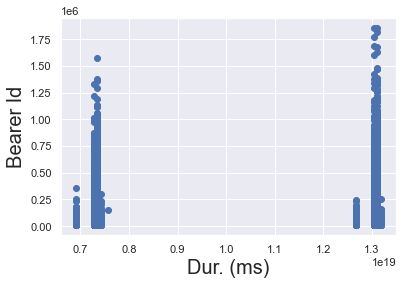

In [29]:
y = db['Dur. (ms)']
x1 = db['Bearer Id']

plt.scatter(x1,y)
plt.xlabel('Dur. (ms)', fontsize=20)
plt.ylabel('Bearer Id', fontsize = 20)
plt.show()

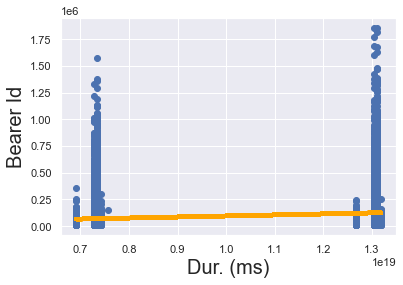

In [30]:
plt.scatter(x1,y)
yhat = 9.557e-15 * x1 + 8.717e-34
fig = plt.plot(x1,yhat, lw=4, c= 'orange', label = 'regression line')
plt.xlabel ('Dur. (ms)', fontsize = 20)
plt.ylabel ('Bearer Id', fontsize = 20)
plt.show()

In [31]:
# will give us the counts of unique values in day variable. 
# If we specify normalize=True inside the method, it will give us percentages instead.

db['Bearer Id'].value_counts(normalize=True)

1.304243e+19    0.000107
1.304243e+19    0.000067
1.304243e+19    0.000060
1.304243e+19    0.000060
1.304243e+19    0.000060
1.304243e+19    0.000060
1.304243e+19    0.000054
1.304243e+19    0.000054
1.304243e+19    0.000054
1.311448e+19    0.000054
1.304243e+19    0.000047
1.304243e+19    0.000047
1.311448e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000047
1.304243e+19    0.000040
1.304243e+19    0.000040
1.311448e+19    0.000040
1.304243e+19    0.000040
7.349883e+18    0.000040
1.311448e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.311448e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040
1.311448e+19    0.000040
1.304243e+19    0.000040
1.304243e+19    0.000040


In [32]:
data_usage = db[["MSISDN/Number","Dur. (ms).1", "Total DL (Bytes)", "Total UL (Bytes)"]]

data_usage.groupby(["MSISDN/Number"]).agg('sum')

# This one aggregate total dl and total ul per misisdn number.

,Dur. (ms).1,Total DL (Bytes),Total UL (Bytes)
MSISDN/Number,,,
3.360100e+10,1.167201e+08,8.426375e+08,36053108.0
3.360100e+10,1.812310e+08,1.207552e+08,36104459.0
3.360100e+10,1.349694e+08,5.566597e+08,39306820.0
3.360101e+10,4.987802e+07,4.019932e+08,20327526.0
3.360101e+10,3.710445e+07,1.363130e+09,94280527.0
3.360101e+10,2.539831e+08,5.552080e+08,60009249.0
3.360101e+10,1.283605e+08,5.530412e+08,101681858.0
3.360101e+10,8.639998e+07,2.940851e+08,38575279.0
3.360101e+10,4.957021e+08,8.965602e+08,93572016.0


In [33]:
from sklearn.preprocessing import Normalizer, MinMaxScaler
from sklearn.cluster import KMeans


def normalizer(df, columns):
    norm = Normalizer()
    return pd.DataFrame(norm.fit_transform(df), columns=columns)

def scaler(df, columns):
    minmax_scaler = MinMaxScaler()
    return pd.DataFrame(minmax_scaler.fit_transform(df), columns=columns)

def scale_and_normalize(df,columns ):
    return normalizer(scaler(df, columns), columns)
    

In [36]:
db.dtypes

Bearer Id                                          float64
Start                                       datetime64[ns]
Start ms                                           float64
End                                         datetime64[ns]
End ms                                             float64
Dur. (ms)                                          float64
IMSI                                               float64
MSISDN/Number                                      float64
IMEI                                               float64
Last Location Name                                  object
Avg RTT DL (ms)                                    float64
Avg RTT UL (ms)                                    float64
Avg Bearer TP DL (kbps)                            float64
Avg Bearer TP UL (kbps)                            float64
TCP DL Retrans. Vol (Bytes)                        float64
TCP UL Retrans. Vol (Bytes)                        float64
DL TP < 50 Kbps (%)                                float

In [34]:
engagment_metrics = db.groupby('MSISDN/Number').agg({'Bearer Id': 'count','Dur. (ms)': 'sum', 'total_data': 'sum',})
engagment_metrics = engagment_metrics.rename(columns={'Bearer Id': 'sessions_frequency', 'total_data': 'total_traffic'})
engagment_metrics.sort_values(by=['sessions_frequency'], ascending=False).head(10)

SpecificationError: Column(s) ['total_data'] do not exist

In [17]:
engagment_metrics.describe()


,sessions_frequency,Dur. (ms),total_traffic
count,106856.000000,1.068560e+05,1.068560e+05
mean,1.403768,1.468461e+05,1.154490e+08
std,3.408147,3.093849e+05,2.841911e+08
min,1.000000,7.142000e+03,5.733784e+06
25%,1.000000,7.130800e+04,7.279095e+07
50%,1.000000,1.027400e+05,9.358773e+07
75%,2.000000,1.727990e+05,1.314640e+08
max,1084.000000,8.133623e+07,9.004916e+10


In [27]:

def plot_box(df:pd.DataFrame, x_col:str, title:str) -> None:
    plt.figure(figsize=(12, 7))
    sns.boxplot(data = df, x=x_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.show()

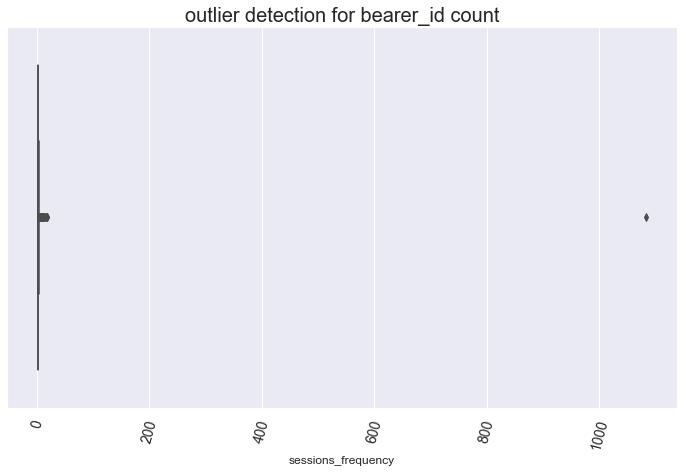

In [29]:
plot_box(engagment_metrics, 'sessions_frequency', 'outlier detection for bearer_id count')

In [32]:
def handle_outliers(df, col):
    df = df.copy()
    q1 = df[col].quantile(0.25)
    q3 = df[col].quantile(0.75)
    
    lower_bound = q1 - ((1.5) * (q3 - q1))
    upper_bound = q3 + ((1.5) * (q3 - q1))
    
    df[col] = np.where(df[col] < lower_bound, lower_bound, df[col])
    df[col] = np.where(df[col] > upper_bound, upper_bound, df[col])
    
    return df



In [34]:
cleaned_engagment_metrics = handle_outliers(engagment_metrics, 'sessions_frequency')
cleaned_engagment_metrics = handle_outliers(cleaned_engagment_metrics, 'Dur. (ms)')
cleaned_engagment_metrics = handle_outliers(cleaned_engagment_metrics, 'total_traffic')
cleaned_engagment_metrics.describe()


,sessions_frequency,Dur. (ms),total_traffic
count,106856.000000,106856.000000,1.068560e+05
mean,1.359582,130253.994394,1.083001e+08
std,0.653562,87611.985353,5.021541e+07
min,1.000000,7142.000000,5.733784e+06
25%,1.000000,71308.000000,7.279095e+07
50%,1.000000,102740.000000,9.358773e+07
75%,2.000000,172799.000000,1.314640e+08
max,3.500000,325035.500000,2.194735e+08


In [35]:
normalized_metrics = scale_and_normalize(cleaned_engagment_metrics, ['sessions_frequency', 'duration', 'total_traffic'])
normalized_metrics.describe()

,sessions_frequency,duration,total_traffic
count,106856.000000,106856.000000,106856.000000
mean,0.120346,0.549086,0.743574
std,0.202687,0.241667,0.177864
min,0.000000,0.000000,0.000000
25%,0.000000,0.390973,0.615457
50%,0.000000,0.577350,0.762862
75%,0.315022,0.735002,0.882337
max,0.765351,1.000000,1.000000


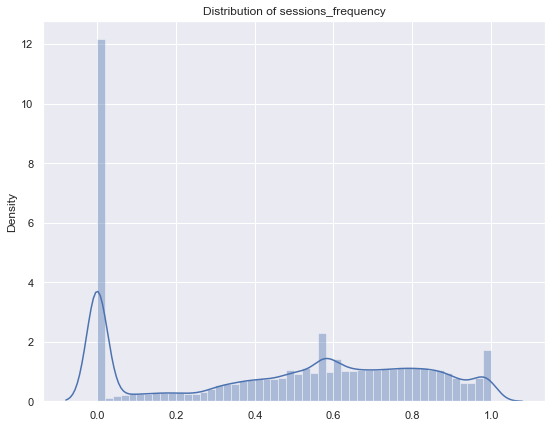

In [36]:
def plot_dist(df: pd.DataFrame, column: str):
    plt.figure(figsize=(9, 7))
    sns.distplot(df).set_title(f'Distribution of {column}')
    plt.show()
    
plot_dist(normalized_metrics, 'sessions_frequency',)

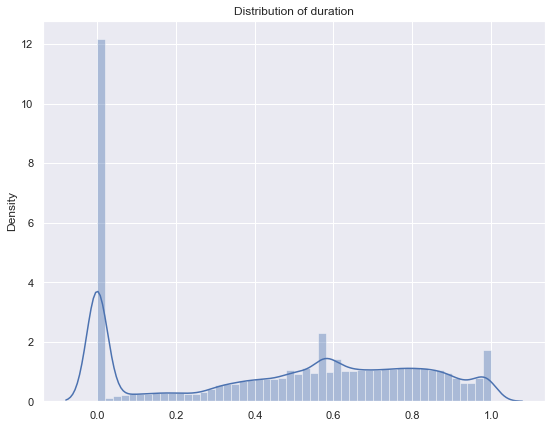

In [37]:
plot_dist(normalized_metrics, 'duration',)

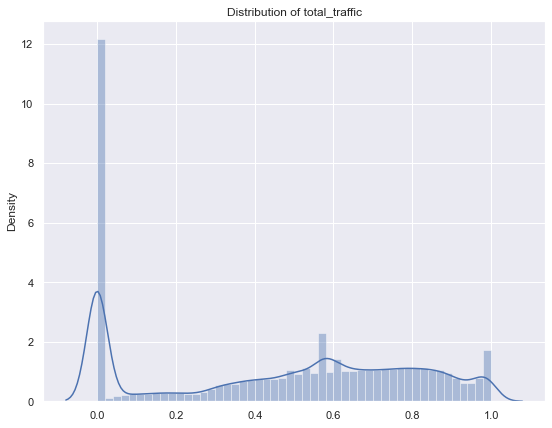

In [38]:
plot_dist(normalized_metrics, 'total_traffic',)

In [39]:
kmeans = KMeans(n_clusters=3, init='k-means++').fit(normalized_metrics)
pred = kmeans.predict(normalized_metrics)

engagment_metrics_with_cluster = cleaned_engagment_metrics.copy()
engagment_metrics_with_cluster['clusters'] = pred

In [40]:
def cluser_label(x: int, cols: list = []) -> str:
    if (not type(x) == int):
        return x
    if (x < len(cols)):
        return cols[x]

    return str(x)
    

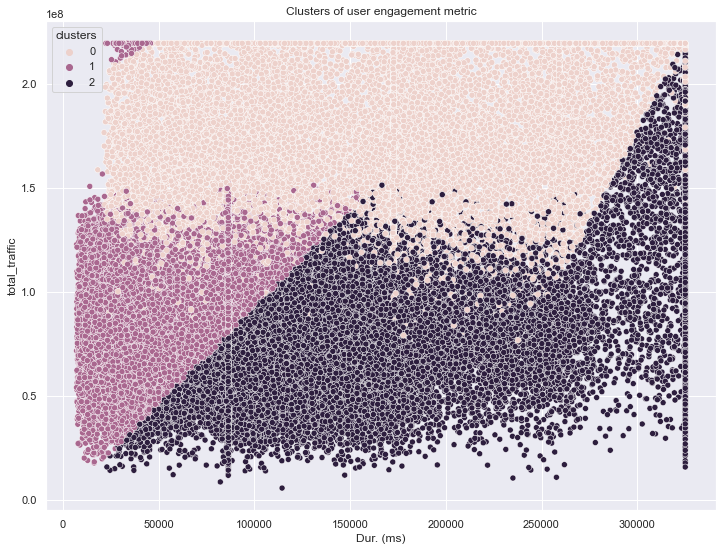

2    44283
1    36758
0    25815
Name: clusters, dtype: int64

In [42]:

# labels = ['cluser_1', 'cluser_2', 'cluser_3']

# engagment_metrics_with_cluster['clusters']  = engagment_metrics_with_cluster['clusters'].map(lambda x:
#                                                                                              cluser_label(x, labels))
engagment_metrics_with_cluster['clusters'].value_counts()

plt.figure(figsize=(12,9))

sns.scatterplot(x = 'Dur. (ms)', y='total_traffic',
                hue='clusters', data=engagment_metrics_with_cluster).set_title('Clusters of user engagement metric')

plt.show()
# engagment_metrics_with_cluster.describe()
engagment_metrics_with_cluster['clusters'].value_counts()


In [45]:
print("Describing cluser 1 ")
print("======================")
cluser_1 =  engagment_metrics_with_cluster[engagment_metrics_with_cluster['clusters'] == 0]
cluser_1.describe()


Describing cluser 1 


,sessions_frequency,Dur. (ms),total_traffic,clusters
count,25815.000000,25815.000000,2.581500e+04,25815.0
mean,2.360198,192757.354658,1.800871e+08,0.0
std,0.570016,91497.208122,3.512179e+07,0.0
min,2.000000,18235.000000,5.913970e+07,0.0
25%,2.000000,116646.000000,1.533844e+08,0.0
50%,2.000000,181779.000000,1.821749e+08,0.0
75%,3.000000,265481.000000,2.194735e+08,0.0
max,3.500000,325035.500000,2.194735e+08,0.0


In [46]:
print("Describing cluser 2 ")
print("======================")
cluser_1 =  engagment_metrics_with_cluster[engagment_metrics_with_cluster['clusters'] == 1]
cluser_1.describe()

Describing cluser 2 


,sessions_frequency,Dur. (ms),total_traffic,clusters
count,36758.000000,36758.000000,3.675800e+04,36758.0
mean,1.002095,54973.106045,9.050176e+07,1.0
std,0.045721,30300.303483,2.186495e+07,0.0
min,1.000000,7142.000000,1.777360e+07,1.0
25%,1.000000,27391.500000,7.712549e+07,1.0
50%,1.000000,50004.000000,9.102466e+07,1.0
75%,1.000000,86399.000000,1.048446e+08,1.0
max,2.000000,155090.000000,2.194735e+08,1.0


In [47]:
print("Describing cluser 3 ")
print("======================")
cluser_1 =  engagment_metrics_with_cluster[engagment_metrics_with_cluster['clusters'] == 2]
cluser_1.describe()

Describing cluser 3 


,sessions_frequency,Dur. (ms),total_traffic,clusters
count,44283.000000,44283.000000,4.428300e+04,44283.0
mean,1.073008,156305.767055,8.122545e+07,2.0
std,0.260152,72245.860214,3.112156e+07,0.0
min,1.000000,22998.000000,5.733784e+06,2.0
25%,1.000000,97932.000000,6.184557e+07,2.0
50%,1.000000,139541.000000,7.607408e+07,2.0
75%,1.000000,178341.500000,9.402249e+07,2.0
max,2.000000,325035.500000,2.194735e+08,2.0


In [56]:

app_metrics = []

app_columns = ['social_media', 'google', 'email', 'youtube', 'netflix', 'gaming']

app_metrics = db.groupby('MSISDN/Number').agg({'social_media': 'sum',
                                        'google': 'sum',
                                        'email': 'sum',
                                        'youtube': 'sum',
                                        'netflix': 'sum', 
                                        'gaming': 'sum'})


In [57]:

app_total_df = pd.DataFrame(columns=['app', 'total'])
app_total_df['app'] = app_columns

app_metrics
app_totals = [ ]
for app in app_columns:
    app_totals.append(app_metrics.sum()[app])
app_total_df['total'] =app_totals
    
app_total_df


,app,total
0,social_media,2.742394e+11
1,google,1.171102e+12
2,email,3.388676e+11
3,youtube,3.396545e+12
4,netflix,3.394314e+12
5,gaming,6.455040e+13


In [59]:
def plot_bar(df: pd.DataFrame, x_col: str, y_col: str, title: str, xlabel: str, ylabel: str) -> None:
    plt.figure(figsize=(9, 7))
    sns.barplot(data=df, x=x_col, y=y_col)
    plt.title(title, size=20)
    plt.xticks(rotation=75, fontsize=14)
    plt.yticks(fontsize=14)
    plt.xlabel(xlabel, fontsize=16)
    plt.ylabel(ylabel, fontsize=16)
    plt.show()


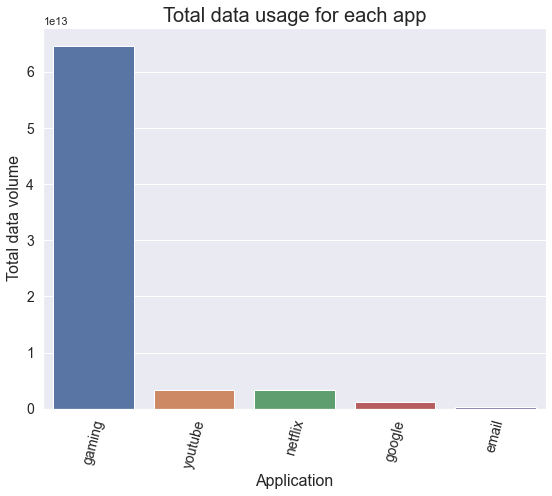

In [60]:
plot_bar(app_total_df.sort_values(by=['total'],
                                  ascending = False).head(),
         x_col='app', y_col='total', title="Total data usage for each app",
         xlabel="Application", ylabel="Total data volume")


In [63]:

inertias = []
for k in range(1, 20):
    
    kmeans = KMeans(n_clusters=k).fit(normalized_metrics)
    inertias.append([k, kmeans.inertia_])

    



Text(0, 0.5, 'Inertia')

<Figure size 720x504 with 0 Axes>

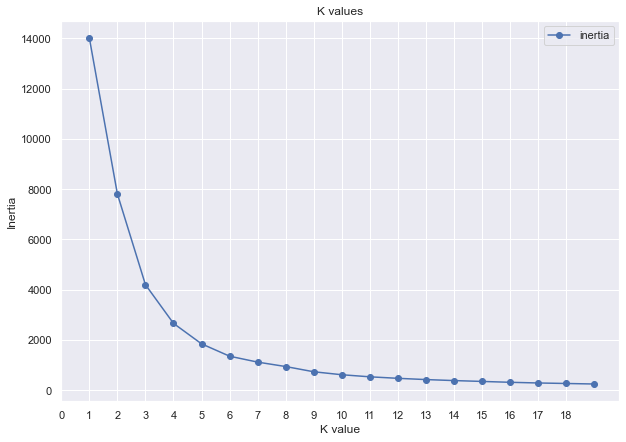

In [64]:

k_df = pd.DataFrame(columns=['k', 'inertia'])
k_df['k'] = [i[0] for i in inertias]
k_df['inertia'] = [i[1] for i in inertias]


plt.figure(figsize=(10,7))

k_df.plot( x='k', y='inertia', linestyle='-',
          marker='o', figsize=(10,7), title='K values').set_xlabel("K values")
plt.xticks(np.arange(len(k_df.index)))
plt.xlabel('K value')
plt.ylabel('Inertia')


# k_df.plot(inertias, linestyle='-', marker='o', )


In [65]:
kmeans_2 = KMeans(n_clusters=3, init='k-means++').fit(normalized_metrics)
pred = kmeans_2.predict(normalized_metrics)

engagment_metrics_with_cluster2 = cleaned_engagment_metrics.copy()
engagment_metrics_with_cluster2['clusters'] = pred

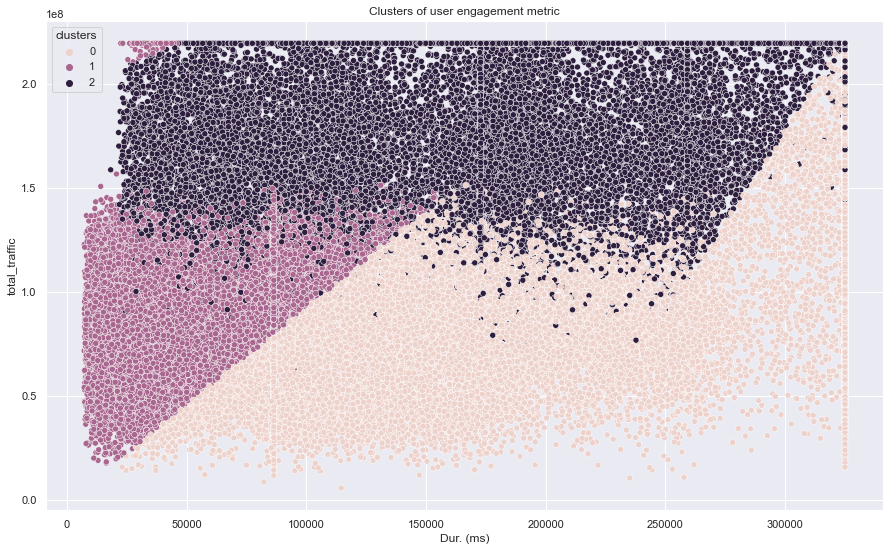

,sessions_frequency,Dur. (ms),total_traffic,clusters
count,106856.000000,106856.000000,1.068560e+05,106856.000000
mean,1.359582,130253.994394,1.083001e+08,1.172831
std,0.653562,87611.985353,5.021541e+07,0.791290
min,1.000000,7142.000000,5.733784e+06,0.000000
25%,1.000000,71308.000000,7.279095e+07,1.000000
50%,1.000000,102740.000000,9.358773e+07,1.000000
75%,2.000000,172799.000000,1.314640e+08,2.000000
max,3.500000,325035.500000,2.194735e+08,2.000000


In [67]:
# labels = ['cluser_1', 'cluser_2', 'cluser_3', 'cluser_4']

# engagment_metrics_with_cluster['clusters']  = engagment_metrics_with_cluster['clusters'].map(lambda x:
#                                                                                              cluser_label(x, labels))
engagment_metrics_with_cluster['clusters'].value_counts()
plt.figure(figsize=(15,9))

sns.scatterplot(x = 'Dur. (ms)', y='total_traffic',
                hue='clusters', data=engagment_metrics_with_cluster2).set_title('Clusters of user engagement metric')

plt.show()
engagment_metrics_with_cluster.describe()